In [1]:
import os
import scanpy as sc
import numpy as np
import scvelo as scv
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math
import pickle

In [2]:
embs = {'dentategyrus_scv':'umap',
        'DentateGyrus_velocyto':'tsne',
        'endocrinogenesis_day15':'umap',
        'human_cd34_bone_marrow':'tsne',
        'Forebrain':'umap',
        'gastrulation':'umap',
        'erythroid_lineage':'umap',
        'Hindbrain_GABA_Glio':'tsne',
        'organogenesis_chondrocyte':'umap',
        'zebrafish_process':'umap'}
cell_types = {
    'endocrinogenesis_day15':['clusters'],
    'DentateGyrus_velocyto':['clusters'],
    'human_cd34_bone_marrow':['clusters'],
    'Forebrain':['clusters'],
    'dentategyrus_scv':['clusters'],
    'Hindbrain_GABA_Glio':['Celltype'],
    'organogenesis_chondrocyte':['Main_cell_type'],
    'erythroid_lineage':['celltype'],
    'zebrafish_process':['Cell_type'],
    'gastrulation':['stage']}
files = [key for key in cell_types.keys()]

methods = {
    'velocyto':'velocity',
    'scvelo_stochastic':'velocity',
    'scvelo_dynamical':'velocity',
    'VeloAE':'new_velocity',
    'Dynamo_stochastic':'velocity_S',
    'veloVAE':'vae_velocity', #'vae_velocity_s',
    'UniTvelo':'velocity',
    'DeepVelo_SA':'DSA_velocity',
    'Celldancer':'cd_velocity_s',
    'veloVI':'velocity', # 'velocity_s',
    'LatentVelo':'velo_s',
    'DeepVelo_GB':'velocity',
    'STT':'velocity',
    'TFvelo':'velocity'}

method_replacements = {
    "Velocyto": "velocyto",
    "scvelo_stochastic": "scVelo(sto)",
    "scvelo_dynamical": "scVelo(dyn)",
    "veloAE": "VeloAE",
    "Dynamo_stochastic": "dynamo",
    "veloVAE": "VeloVAE",
    "UniTvelo": "UniTVelo",
    "DeepVelo_SA": "DeepVelo(VAE)",
    "Celldancer": "cellDancer",
    "velovi": "veloVI",
    "Latentvelo": "LatentVelo",
    "DeepVelo_GB": "DeepVelo(GCN)",
    "stt": "STT",
    "multivelo": "MultiVelo",
    "phylovelo": "PhyloVelo",
    "tfvelo": "TFvelo"
}

def check_adata(adata,method,vkey,file_name):
    if not isinstance(adata.layers[vkey], np.ndarray) and 'Dynamo' in method  :
        adata.layers[vkey] = adata.layers[vkey].toarray()#dynamo
        
    if 'scvelo' in method:
        arr = adata.layers[vkey]
        all_nan_columns = np.where(np.isnan(arr).all(axis=0))[0].tolist()
        if all_nan_columns:
            adata._inplace_subset_var(np.delete(adata.var_names, all_nan_columns))
    if file_name == 'gastrulation':
        adata.obs['stage'] = pd.Categorical(adata.obs['stage'], ordered=True,
                                            categories=['E6.5','E6.75',
                                                        'E7.0','E7.25','E7.5','E7.75',
                                                        'E8.0','E8.25','E8.5'])
    if file_name == 'DentateGyrus_velocyto':
        replace_dict = {'RadialGlia': 'Radial Glia',
                        'RadialGlia2': 'Radial Glia',
                        'ImmAstro': 'Astrocyte',
                        'ImmGranule1':'Immature Granule',
                        'ImmGranule2':'Immature Granule',
                        'Nbl1':'Neuroblast',
                        'Nbl2':'Neuroblast'
                        }
        adata.obs.replace(replace_dict, inplace=True)

    if file_name == 'human_cd34_bone_marrow':
        replace_dict = {'HSC_1': 'HSC',
                        'HSC_2': 'HSC',
                        'Ery_1': 'Ery',
                        'Ery_2': 'Ery',
                        'Mono_1': 'Mono',
                        'Mono_2': 'Mono'}
        adata.obs.replace(replace_dict, inplace=True)
        adata.obs['clusters'] = pd.Categorical(adata.obs['clusters'], ordered=True,
                                            categories=['HSC', 'Ery', 'Mono','Precursors','CLP','DCs','Mega'])
        adata.uns['clusters_colors'] = ['#f781bf', '#a6d854', '#e41a1c', '#984ea3', '#e5c494','#e41a1c', '#a6cee3', '#ff7f00']

    if file_name == 'erythroid_lineage':
        replace_dict = {'Blood progenitors 1': 'Blood progenitors',
                        'Blood progenitors 2': 'Blood progenitors',
                        }
        adata.obs.replace(replace_dict, inplace=True)
        adata.uns['celltype_colors'] = ['#c9a997', '#C72228', '#f79083', '#EF4E22']
        
    return adata


--------------endocrinogenesis_day15-----------------
velocyto
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:20) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_dynamical
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
VeloAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'new_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'new_velocity_umap', embedded velocity vectors (adata.obsm)
Dynamo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'velocity_S_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_S_umap', embedded velocity vectors (adata.obsm)
veloVAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'vae_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vae_velocity_umap', embedded velocity vectors (adata.obsm)
UniTvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
DeepVelo_SA
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'DSA_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'DSA_velocity_umap', embedded velocity vectors (adata.obsm)
Celldancer
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'cd_velocity_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'cd_velocity_s_umap', embedded velocity vectors (adata.obsm)
veloVI
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
LatentVelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'velo_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velo_s_umap', embedded velocity vectors (adata.obsm)
DeepVelo_GB
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
STT
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
TFvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


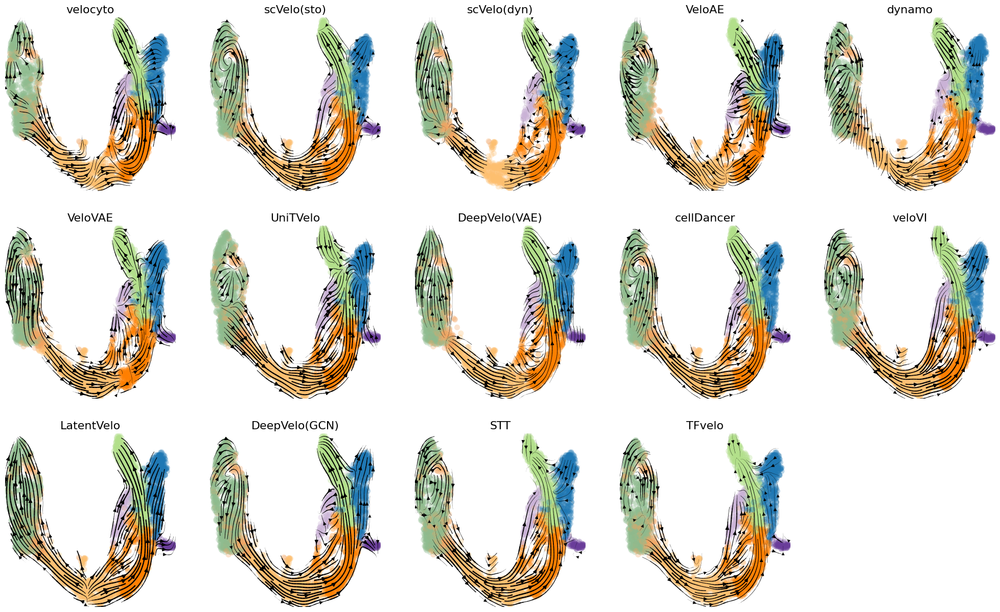

--------------DentateGyrus_velocyto-----------------
velocyto
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:25) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
scvelo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:25) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
scvelo_dynamical
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:21) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
VeloAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:16) --> added 
    'new_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'new_velocity_tsne', embedded velocity vectors (adata.obsm)
Dynamo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:27) --> added 
    'velocity_S_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:06) --> added
    'velocity_S_tsne', embedded velocity vectors (adata.obsm)
veloVAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:26) --> added 
    'vae_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'vae_velocity_tsne', embedded velocity vectors (adata.obsm)
UniTvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:21) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
DeepVelo_SA
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:20) --> added 
    'DSA_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'DSA_velocity_tsne', embedded velocity vectors (adata.obsm)
Celldancer
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:26) --> added 
    'cd_velocity_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'cd_velocity_s_tsne', embedded velocity vectors (adata.obsm)
veloVI
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:21) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
LatentVelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:26) --> added 
    'velo_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'velo_s_tsne', embedded velocity vectors (adata.obsm)
DeepVelo_GB
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:25) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
STT
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:21) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
TFvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/18213 [00:00<?, ?cells/s]

    finished (0:00:24) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:05) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)


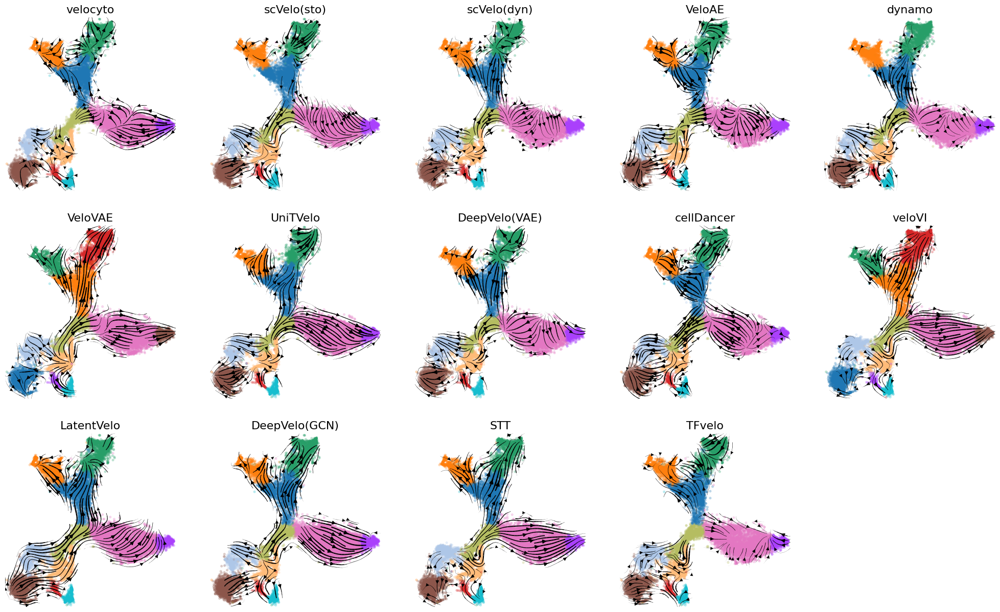

--------------human_cd34_bone_marrow-----------------
velocyto
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:09) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
scvelo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:07) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
scvelo_dynamical
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:07) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
VeloAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:06) --> added 
    'new_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'new_velocity_tsne', embedded velocity vectors (adata.obsm)
Dynamo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:09) --> added 
    'velocity_S_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_S_tsne', embedded velocity vectors (adata.obsm)
veloVAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:08) --> added 
    'vae_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vae_velocity_tsne', embedded velocity vectors (adata.obsm)
UniTvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
DeepVelo_SA
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:06) --> added 
    'DSA_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'DSA_velocity_tsne', embedded velocity vectors (adata.obsm)
Celldancer
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:09) --> added 
    'cd_velocity_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'cd_velocity_s_tsne', embedded velocity vectors (adata.obsm)
veloVI
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
LatentVelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:09) --> added 
    'velo_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velo_s_tsne', embedded velocity vectors (adata.obsm)
DeepVelo_GB
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:07) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
STT
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5780 [00:00<?, ?cells/s]

    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
TFvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/5756 [00:00<?, ?cells/s]

    finished (0:00:08) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)


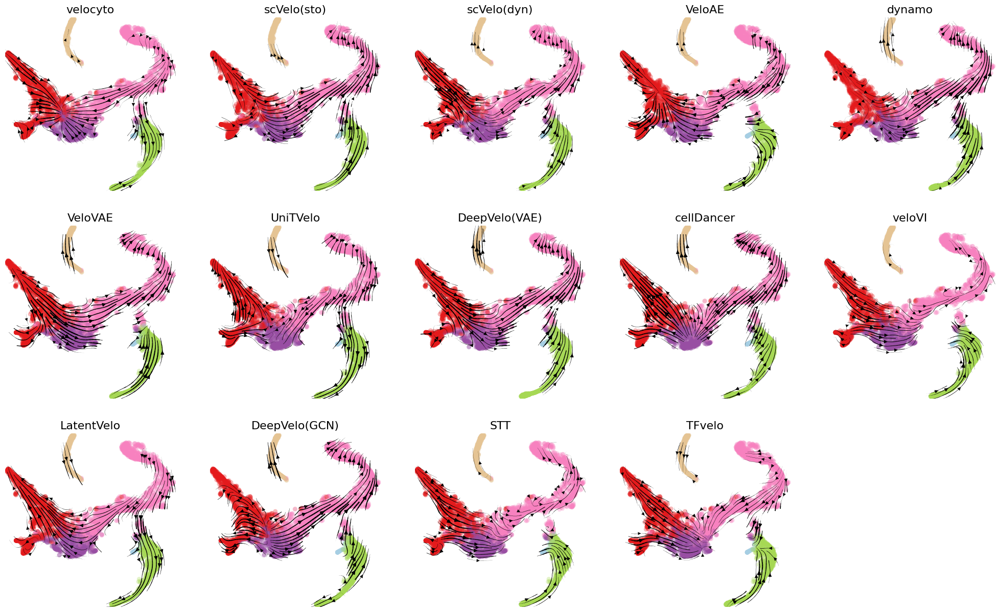

--------------Forebrain-----------------
velocyto
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_dynamical
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
VeloAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'new_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'new_velocity_umap', embedded velocity vectors (adata.obsm)
Dynamo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_S_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_S_umap', embedded velocity vectors (adata.obsm)
veloVAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'vae_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vae_velocity_umap', embedded velocity vectors (adata.obsm)
UniTvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
DeepVelo_SA
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'DSA_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'DSA_velocity_umap', embedded velocity vectors (adata.obsm)
Celldancer
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'cd_velocity_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'cd_velocity_s_umap', embedded velocity vectors (adata.obsm)
veloVI
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
LatentVelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velo_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velo_s_umap', embedded velocity vectors (adata.obsm)
DeepVelo_GB
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
STT
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
TFvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/1720 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


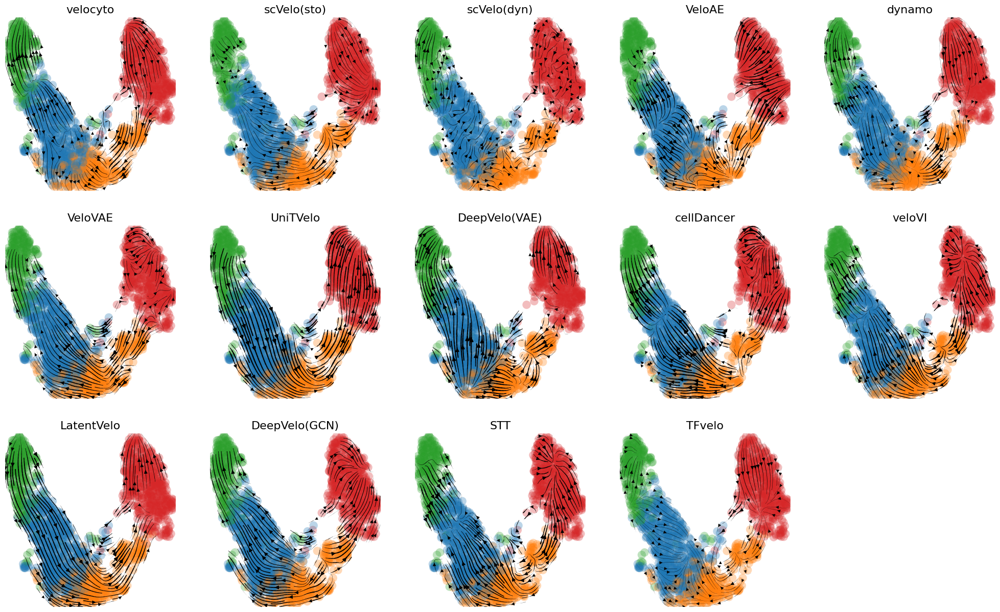

--------------dentategyrus_scv-----------------
velocyto
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_dynamical
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
VeloAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'new_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'new_velocity_umap', embedded velocity vectors (adata.obsm)
Dynamo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_S_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_S_umap', embedded velocity vectors (adata.obsm)
veloVAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'vae_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vae_velocity_umap', embedded velocity vectors (adata.obsm)
UniTvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
DeepVelo_SA
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'DSA_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'DSA_velocity_umap', embedded velocity vectors (adata.obsm)
Celldancer
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'cd_velocity_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'cd_velocity_s_umap', embedded velocity vectors (adata.obsm)
veloVI
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
LatentVelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velo_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velo_s_umap', embedded velocity vectors (adata.obsm)
DeepVelo_GB
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
STT
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
TFvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/2930 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


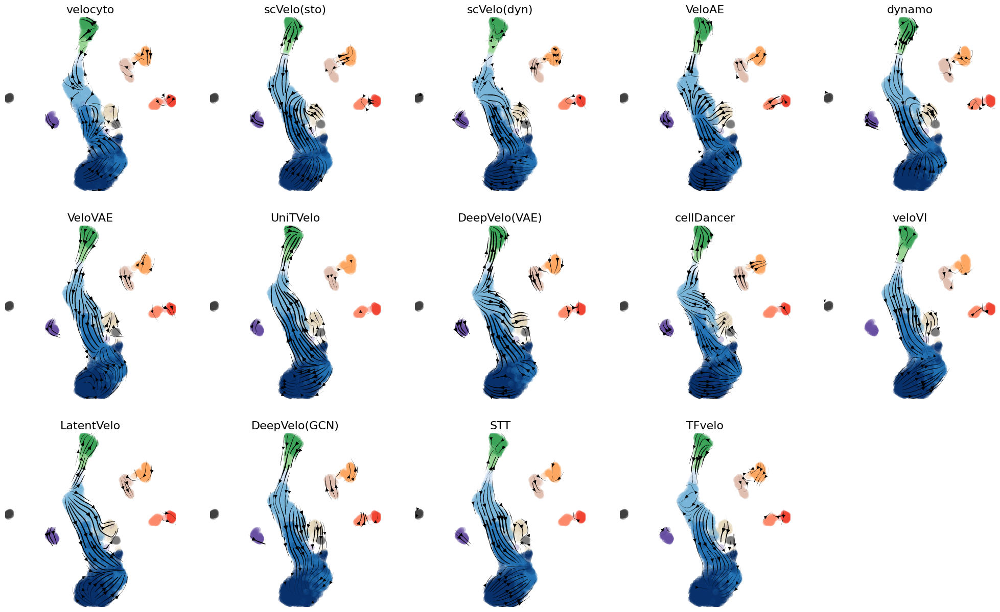

--------------Hindbrain_GABA_Glio-----------------
velocyto
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:17) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:03) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
scvelo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:16) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:03) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
scvelo_dynamical
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:13) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:04) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
VeloAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:10) --> added 
    'new_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:03) --> added
    'new_velocity_tsne', embedded velocity vectors (adata.obsm)
Dynamo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:18) --> added 
    'velocity_S_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:04) --> added
    'velocity_S_tsne', embedded velocity vectors (adata.obsm)
veloVAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:17) --> added 
    'vae_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:04) --> added
    'vae_velocity_tsne', embedded velocity vectors (adata.obsm)
UniTvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:15) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:03) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
DeepVelo_SA
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:13) --> added 
    'DSA_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:03) --> added
    'DSA_velocity_tsne', embedded velocity vectors (adata.obsm)
Celldancer
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:23) --> added 
    'cd_velocity_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:04) --> added
    'cd_velocity_s_tsne', embedded velocity vectors (adata.obsm)
veloVI
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:15) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:03) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
LatentVelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:18) --> added 
    'velo_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:03) --> added
    'velo_s_tsne', embedded velocity vectors (adata.obsm)
DeepVelo_GB
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:17) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:04) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
STT
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/13501 [00:00<?, ?cells/s]

    finished (0:00:15) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:03) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)
TFvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/12289 [00:00<?, ?cells/s]

    finished (0:00:13) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:03) --> added
    'velocity_tsne', embedded velocity vectors (adata.obsm)


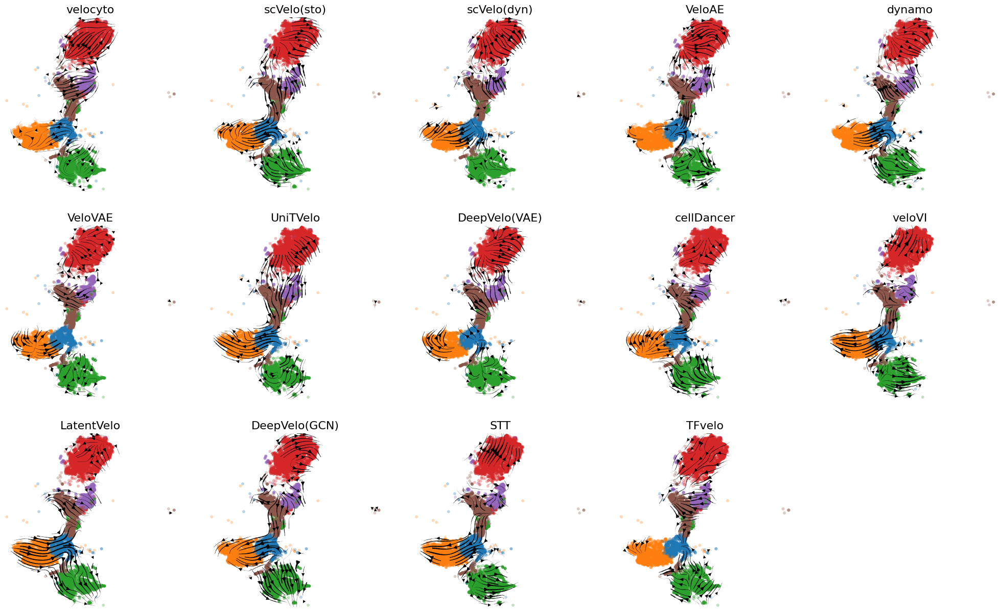

--------------organogenesis_chondrocyte-----------------
velocyto
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:00:47) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:10) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:00:45) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:10) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_dynamical
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:00:36) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:09) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
VeloAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:00:48) --> added 
    'new_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:10) --> added
    'new_velocity_umap', embedded velocity vectors (adata.obsm)
Dynamo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:01:08) --> added 
    'velocity_S_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:11) --> added
    'velocity_S_umap', embedded velocity vectors (adata.obsm)
veloVAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:01:23) --> added 
    'vae_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:11) --> added
    'vae_velocity_umap', embedded velocity vectors (adata.obsm)
UniTvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:00:51) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:10) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
DeepVelo_SA
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:00:46) --> added 
    'DSA_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:09) --> added
    'DSA_velocity_umap', embedded velocity vectors (adata.obsm)
Celldancer
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:01:06) --> added 
    'cd_velocity_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:10) --> added
    'cd_velocity_s_umap', embedded velocity vectors (adata.obsm)
veloVI
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:00:48) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:09) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
LatentVelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:01:09) --> added 
    'velo_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:09) --> added
    'velo_s_umap', embedded velocity vectors (adata.obsm)
DeepVelo_GB
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:00:45) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:09) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
STT
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:00:47) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:09) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
TFvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/30000 [00:00<?, ?cells/s]

    finished (0:00:46) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:10) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


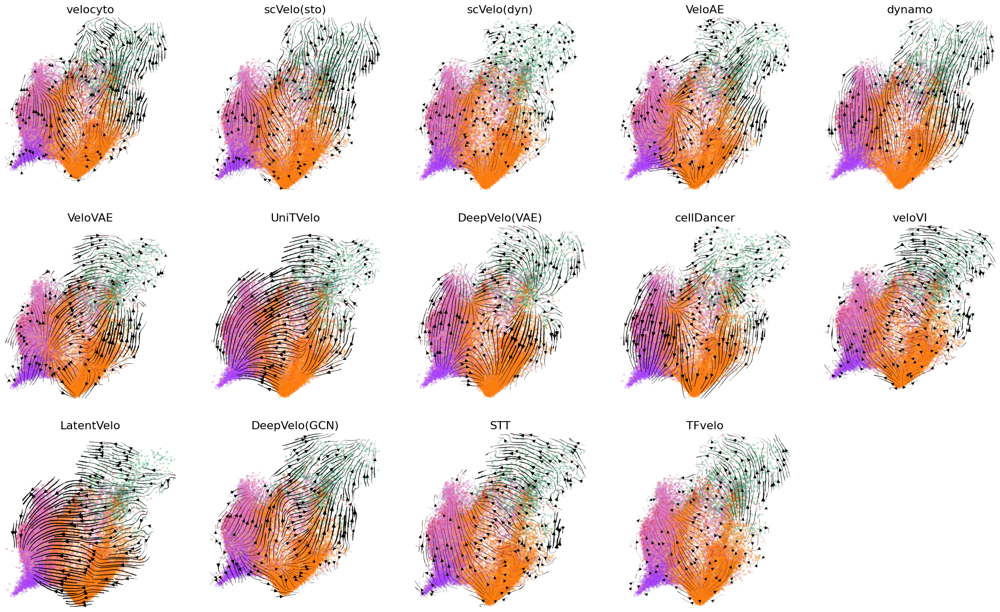

--------------erythroid_lineage-----------------
velocyto
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:15) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:12) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_dynamical
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:12) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
VeloAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:10) --> added 
    'new_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'new_velocity_umap', embedded velocity vectors (adata.obsm)
Dynamo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:16) --> added 
    'velocity_S_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_S_umap', embedded velocity vectors (adata.obsm)
veloVAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:16) --> added 
    'vae_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'vae_velocity_umap', embedded velocity vectors (adata.obsm)
UniTvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:12) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
DeepVelo_SA
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:11) --> added 
    'DSA_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'DSA_velocity_umap', embedded velocity vectors (adata.obsm)
Celldancer
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:15) --> added 
    'cd_velocity_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'cd_velocity_s_umap', embedded velocity vectors (adata.obsm)
veloVI
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:11) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
LatentVelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:15) --> added 
    'velo_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velo_s_umap', embedded velocity vectors (adata.obsm)
DeepVelo_GB
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:12) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
STT
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:11) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
TFvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/9815 [00:00<?, ?cells/s]

    finished (0:00:12) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


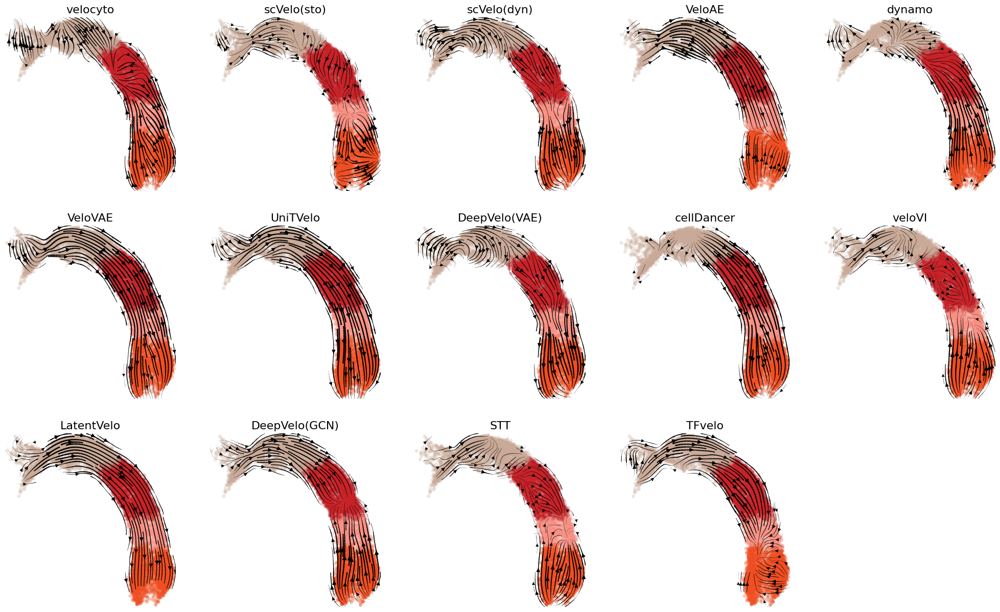

--------------zebrafish_process-----------------
velocyto
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_dynamical
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
VeloAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'new_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'new_velocity_umap', embedded velocity vectors (adata.obsm)
Dynamo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:06) --> added 
    'velocity_S_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_S_umap', embedded velocity vectors (adata.obsm)
veloVAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'vae_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vae_velocity_umap', embedded velocity vectors (adata.obsm)
UniTvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
DeepVelo_SA
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'DSA_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'DSA_velocity_umap', embedded velocity vectors (adata.obsm)
Celldancer
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'cd_velocity_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'cd_velocity_s_umap', embedded velocity vectors (adata.obsm)
veloVI
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
LatentVelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'velo_s_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velo_s_umap', embedded velocity vectors (adata.obsm)
DeepVelo_GB
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
STT
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4181 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
TFvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/4128 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


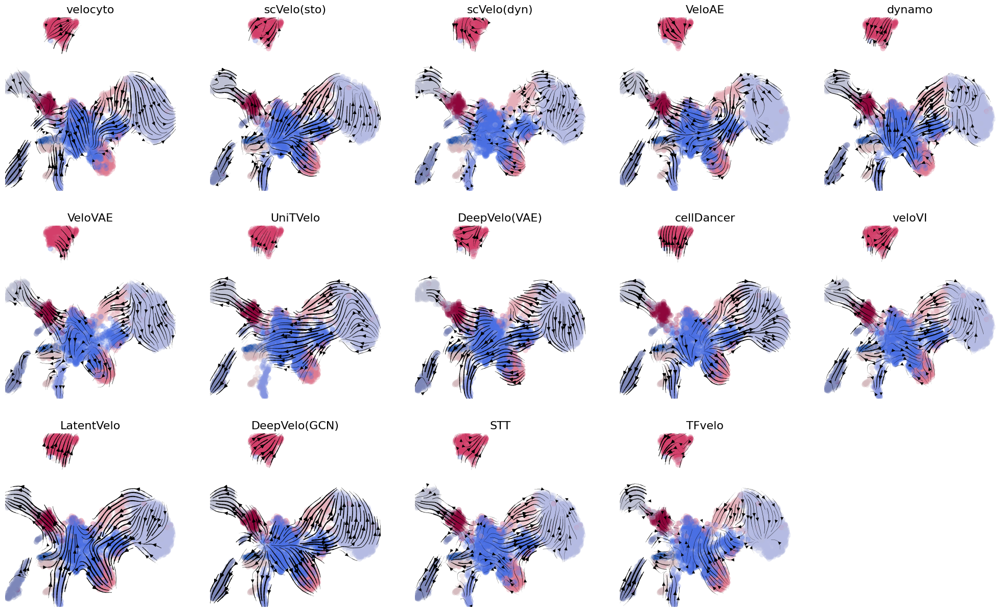

--------------gastrulation-----------------
velocyto
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:02:45) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:32) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:02:21) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:29) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
scvelo_dynamical
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:01:59) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:28) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
VeloAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:01:33) --> added 
    'new_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:26) --> added
    'new_velocity_umap', embedded velocity vectors (adata.obsm)
Dynamo_stochastic
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:02:46) --> added 
    'velocity_S_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:31) --> added
    'velocity_S_umap', embedded velocity vectors (adata.obsm)
veloVAE
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:02:52) --> added 
    'vae_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:33) --> added
    'vae_velocity_umap', embedded velocity vectors (adata.obsm)
UniTvelo
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:03:39) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:28) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
DeepVelo_SA
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:02:26) --> added 
    'DSA_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:28) --> added
    'DSA_velocity_umap', embedded velocity vectors (adata.obsm)
Celldancer
veloVI
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:02:13) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:28) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
LatentVelo
DeepVelo_GB
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:02:25) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:30) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
STT
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 26/52 cores)


  0%|          | 0/89267 [00:00<?, ?cells/s]

    finished (0:02:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:29) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
TFvelo


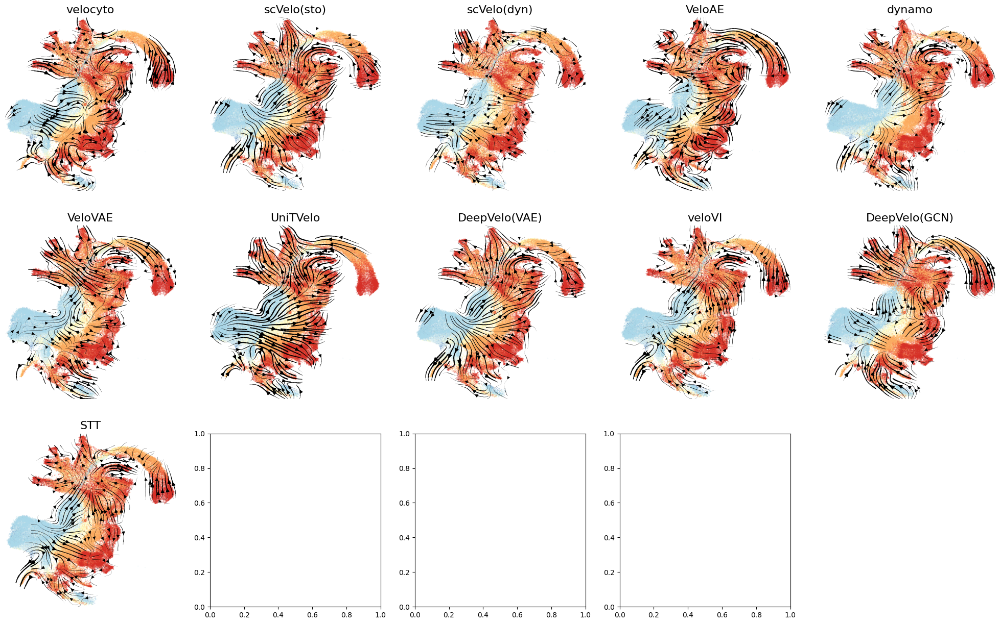

In [3]:
for file_name in files:
    print("--------------" + file_name + "-----------------")
    type = cell_types[file_name]

    nrow = 3
    ncol = 5
    fig, axs = plt.subplots(nrow, ncol, figsize=(5 * ncol, 5 * nrow))
    f = 0

    for method in methods:
        print(method)
        file_path = '/home/liyr/hpz/real_data_graph/{}/{}.h5ad'.format(file_name,method)

        if os.path.exists(file_path):
            adata = sc.read_h5ad(file_path)

            vkey = methods[method]
            emb = embs[file_name]

            adata = check_adata(adata,method,vkey,file_name)
            scv.tl.velocity_graph(adata, basis=emb,vkey=vkey,n_jobs=26)

            r = int(f/ncol)
            c = f % ncol
            ax = axs[r, c]

            if method == 'TFvelo':
                n_cells = adata.shape[0]
                expanded_scaling_y = np.expand_dims(np.array(adata.var['fit_scaling_y']),0).repeat(n_cells,axis=0)
                adata.layers['velocity'] = adata.layers['velo_hat'] / expanded_scaling_y

            if method in method_replacements.keys():
                title_name = method_replacements[method]
            else:
                title_name = method

            # palette
            if file_name == 'gastrulation':
                fig_i = scv.pl.velocity_embedding_stream(adata,ax=ax,
                                                            basis=emb,
                                                            title=title_name,
                                                            vkey=vkey,
                                                            color=type,show=False,
                                                            palette=sns.color_palette("RdYlBu", 9)[::-1],
                                                            legend_loc='none',frameon=False)

            else:
                fig_i = scv.pl.velocity_embedding_stream(adata,ax=ax,
                                                            basis=emb,
                                                            title=title_name,
                                                            vkey=vkey,
                                                            color=type,show=False,
                                                            legend_loc='none',frameon=False)
            ax.axis('off')
            ax.tick_params(top="off",bottom="off",left="off",right="off",labelleft="off",labelbottom="off")
            ax.set_title(ax.get_title(), fontsize=16) 

            f = f+1

    axs[-1, -1].set_visible(False)  # last axs
    axs[-1, -1].set_facecolor('none')  # last axs
    
    graph_save_path ='/home/liyr/hpz/real_graph/{}_merge.svg'.format(file_name)
    
    plt.savefig(graph_save_path,bbox_inches='tight',format='svg')
    plt.show()
